<a href="https://colab.research.google.com/github/yrodriguezmd/IceVision_miniprojects/blob/main/IV_voc_2021_8_26.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
!bash install_colab.sh

--2021-08-26 22:09:02--  https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1244 (1.2K) [text/plain]
Saving to: ‘install_colab.sh’

install_colab.sh    100%[===================>]   1.21K  --.-KB/s    in 0s      

2021-08-26 22:09:02 (60.7 MB/s) - ‘install_colab.sh’ saved [1244/1244]

Installing icevision + dependencices for CUDA 10
Uninstalling some dependencies to prevent errors
Found existing installation: torchvision 0.10.0+cu102
Uninstalling torchvision-0.10.0+cu102:
  Successfully uninstalled torchvision-0.10.0+cu102
Found existing installation: fastai 1.0.61
Uninstalling fastai-1.0.61:
  Successfully uninstalled fastai-1.0.61
Installing some dependencies to prevent errors
     |██

In [1]:
# Imports
from icevision.all import *
import icedata

# Load the Pascal VOC dataset
path = icedata.voc.load_data()

# Get the class_map, a utility that maps from number IDs to classs names
class_map = icedata.voc.class_map()

# Randomly split our data into train/valid
data_splitter = RandomSplitter([0.8, 0.2])

# VOC parser: provided out-of-the-box
#parser = icedata.voc.parser(data_dir=path, class_map=class_map)
#train_records, valid_records = parser.parse(data_splitter)

# shows images with corresponding labels and boxes
#show_records(train_records[:6], ncols=3, class_map=class_map, show=True)

# load the pretrained model
#model = icedata.voc.trained_models.faster_rcnn_resnet50_fpn()

INFO     - Downloading default `.ttf` font file - SpaceGrotesk-Medium.ttf from https://raw.githubusercontent.com/airctic/storage/master/SpaceGrotesk-Medium.ttf to /root/.icevision/fonts/SpaceGrotesk-Medium.ttf | icevision.visualize.utils:get_default_font:69
INFO     - Downloading mmdet configs | icevision.models.mmdet.download_configs:download_mmdet_configs:31


0B [00:00, ?B/s]

  0%|          | 0/1999639040 [00:00<?, ?B/s]

In [45]:
class_map

<ClassMap: {0: 0, 'aeroplane': 1, 'bicycle': 2, 'bird': 3, 'boat': 4, 'bottle': 5, 'bus': 6, 'car': 7, 'cat': 8, 'chair': 9, 'cow': 10, 'diningtable': 11, 'dog': 12, 'horse': 13, 'motorbike': 14, 'person': 15, 'pottedplant': 16, 'sheep': 17, 'sofa': 18, 'train': 19, 'tvmonitor': 20}>

In [2]:
path.ls()

(#6) [Path('/root/.icevision/data/voc/trainval.tar'),Path('/root/.icevision/data/voc/SegmentationObject'),Path('/root/.icevision/data/voc/JPEGImages'),Path('/root/.icevision/data/voc/Annotations'),Path('/root/.icevision/data/voc/ImageSets'),Path('/root/.icevision/data/voc/SegmentationClass')]

In [3]:
# imagesets
(Path('/root/.icevision/data/voc/ImageSets')).ls()

(#4) [Path('/root/.icevision/data/voc/ImageSets/Action'),Path('/root/.icevision/data/voc/ImageSets/Segmentation'),Path('/root/.icevision/data/voc/ImageSets/Layout'),Path('/root/.icevision/data/voc/ImageSets/Main')]

In [4]:
(Path('/root/.icevision/data/voc/ImageSets/Main')).ls()

(#63) [Path('/root/.icevision/data/voc/ImageSets/Main/diningtable_val.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/car_train.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/sofa_val.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/diningtable_train.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/dog_val.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/motorbike_train.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/tvmonitor_trainval.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/person_val.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/sheep_val.txt'),Path('/root/.icevision/data/voc/ImageSets/Main/bottle_train.txt')...]

In [ ]:
import pandas as pd
pd.read_csv(Path('/root/.icevision/data/voc/ImageSets/Main/cat_trainval.txt')).head()

,2008_000002 -1
0,2008_000003 -1
1,2008_000007 -1
2,2008_000008 -1
3,2008_000009 -1
4,2008_000015 -1


In [ ]:
pd.read_csv(Path('/root/.icevision/data/voc/ImageSets/Main/person_val.txt')).head()
## some images with more than one label?

,2008_000002 -1
0,2008_000003 1
1,2008_000007 -1
2,2008_000009 -1
3,2008_000016 -1
4,2008_000021 -1


In [5]:
# images
(Path('/root/.icevision/data/voc/JPEGImages')).ls()
# 17,125 images

(#17125) [Path('/root/.icevision/data/voc/JPEGImages/2008_002158.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2012_003632.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2008_007989.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2008_007890.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2011_005296.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2008_000082.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2009_004889.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2011_004732.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2009_000421.jpg'),Path('/root/.icevision/data/voc/JPEGImages/2009_004454.jpg')...]

In [2]:
parser = parsers.VOCBBoxParser(annotations_dir= path/'Annotations', images_dir = path/'JPEGImages', class_map=class_map)

In [ ]:
#parser = parsers.VOCBBoxParser(annotations_dir= path/'Annotations', images_dir = path/'JPEGImages', class_map=class_map)

In [3]:
train_records, valid_records = parser.parse(data_splitter)


  0%|          | 0/17125 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:136


  0%|          | 0/13700 [00:00<?, ?it/s]

  0%|          | 0/3425 [00:00<?, ?it/s]

  0%|          | 0/17125 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:136


  0%|          | 0/13700 [00:00<?, ?it/s]

  0%|          | 0/3425 [00:00<?, ?it/s]

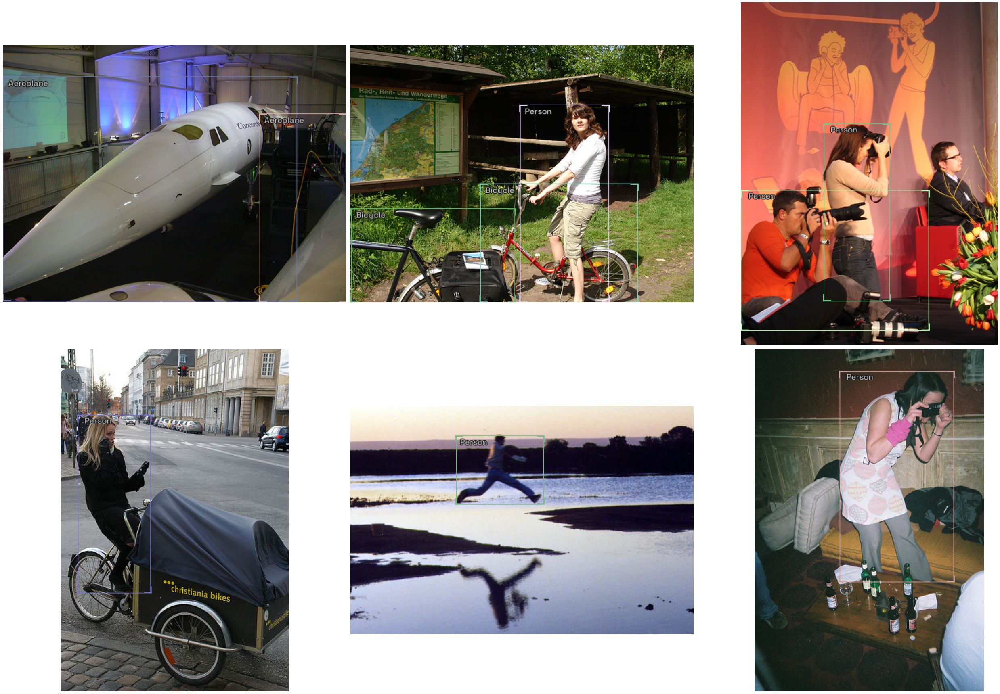

In [7]:

# shows images with corresponding labels and boxes
show_records(train_records[:6], ncols=3, class_map=class_map, show=True)

# load the pretrained model
#model = icedata.voc.trained_models.faster_rcnn_resnet50_fpn()

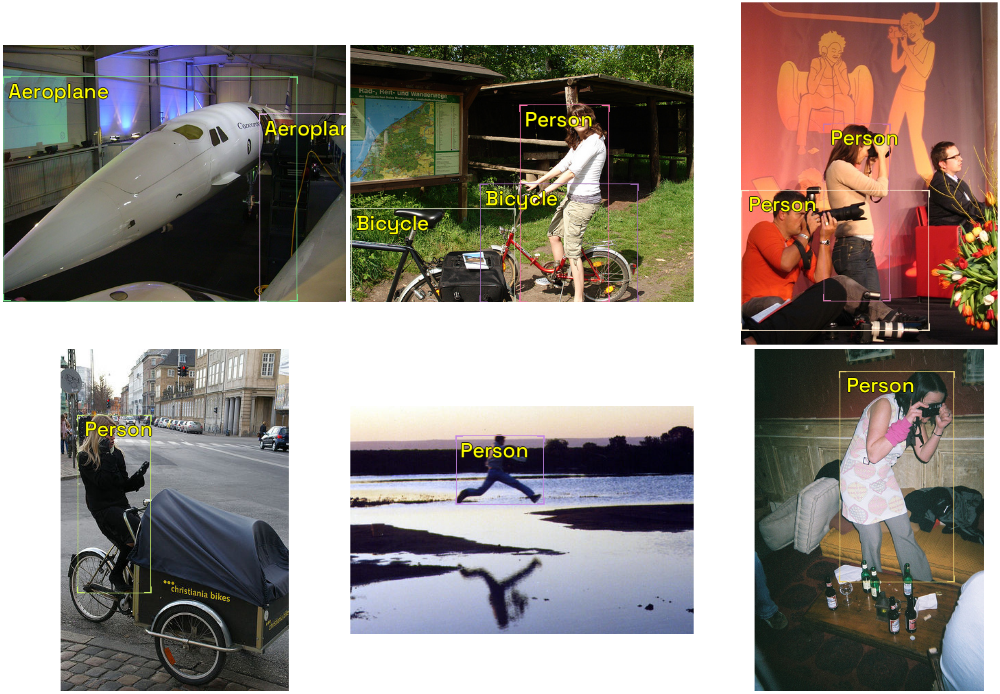

In [9]:
show_records(train_records[:6], ncols=3, class_map=class_map, 
             label_color = '#ffff00', font_size = 30,show=True)


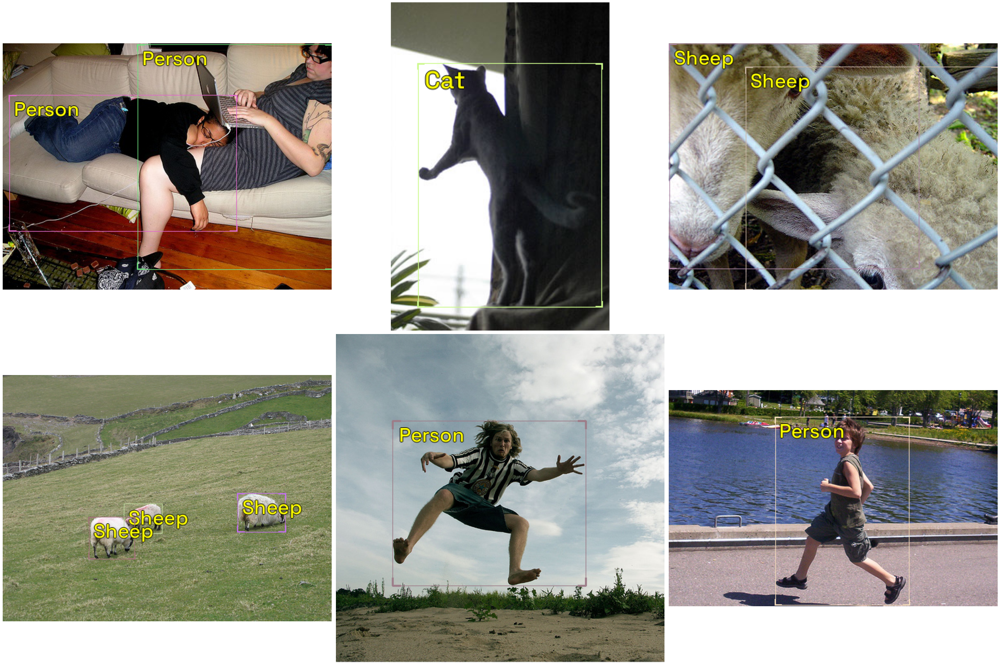

In [10]:
show_records(train_records[6:12], ncols=3, class_map=class_map, 
                          label_color = '#ffff00', font_size = 30,show=True)


In [4]:
image_size = 384
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=512), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

In [20]:
# using faster rcnn: 2-stage
model_type_frcnn = models.torchvision.faster_rcnn ##
#backbone = model_type_ret.backbones.resnet50_fpn_1x(pretrained=True)#
model_frcnn = model_type_frcnn.model( ##
                      num_classes=len(parser.class_map))
train_dl_frcnn = model_type_frcnn.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_frcnn = model_type_frcnn.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)

In [5]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

SuggestedLRs(lr_min=0.0002511886414140463, lr_steep=2.0892961401841603e-05)

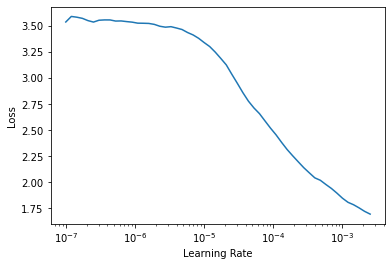

In [21]:
learn_frcnn = model_type_frcnn.fastai.learner(dls=[train_dl_frcnn, ###
                                                   valid_dl_frcnn], #
                                              model=model_frcnn, metrics=metrics)#
learn_frcnn.lr_find()#
## need to rerun model dl to get good lr_find

In [22]:
learn_frcnn.fine_tune(10, 0.00025, freeze_epochs=1) #
## not learning enough
## tried 0.0007, trends not good

epoch,train_loss,valid_loss,COCOMetric,time
0,0.370178,0.362811,0.325650,07:33


epoch,train_loss,valid_loss,COCOMetric,time
0,0.279201,0.285047,0.406352,12:04
1,0.297541,0.283430,0.410323,12:07
2,0.273716,0.283531,0.410801,12:04
3,0.273722,0.281967,0.418781,12:05
4,0.254941,0.274988,0.431693,12:04
5,0.261101,0.272676,0.437538,12:05
6,0.233990,0.267809,0.453296,12:04
7,0.223398,0.264513,0.465507,12:05
8,0.244011,0.264571,0.468958,12:04
9,0.218402,0.263065,0.472426,12:04


In [9]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title, x, y):
  plt.plot(L(learn.recorder.values).itemgot())#
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(x, y, 'Legend: mAP(green), train_loss(blue), valid_loss(orange');

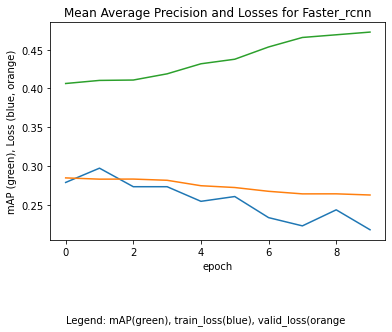

In [28]:
plot_metrics(learn_frcnn, 'Mean Average Precision and Losses for Faster_rcnn', 0,0.1)

  0%|          | 0.00/14.1M [00:00<?, ?B/s]

SuggestedLRs(lr_min=0.0033113110810518267, lr_steep=5.248074739938602e-05)

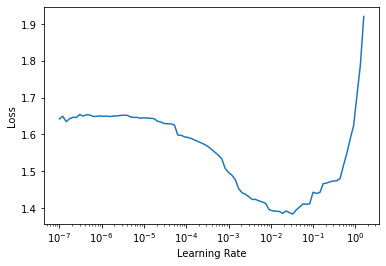

In [25]:
# using YOLOv5: 1-stage
model_type_yolo = models.ultralytics.yolov5 ##
backbone_yolo = model_type_yolo.backbones.small #
model_yolo = model_type_yolo.model(backbone = backbone_yolo(pretrained=True), ###
                      num_classes=len(parser.class_map),
                      img_size = image_size)#
train_dl_yolo = model_type_yolo.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_yolo = model_type_yolo.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)
                                       
learn_yolo = model_type_yolo.fastai.learner(dls=[train_dl_yolo, ###
                                                   valid_dl_yolo], #
                                              model=model_yolo, metrics=metrics)#
learn_yolo.lr_find()#

In [26]:
learn_yolo.fine_tune(10, 0.0033 , freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,0.645158,0.598610,0.279650,02:20


epoch,train_loss,valid_loss,COCOMetric,time
0,0.522484,0.485199,0.411648,02:28
1,0.539907,0.505814,0.396834,02:24
2,0.546998,0.514057,0.396733,02:25
3,0.542303,0.504180,0.408188,02:25
4,0.500305,0.486359,0.424749,02:26
5,0.471170,0.471648,0.449178,02:24
6,0.457926,0.448522,0.468766,02:24
7,0.441820,0.439867,0.482904,02:24
8,0.417328,0.431652,0.491393,02:25
9,0.419967,0.431036,0.497139,02:25


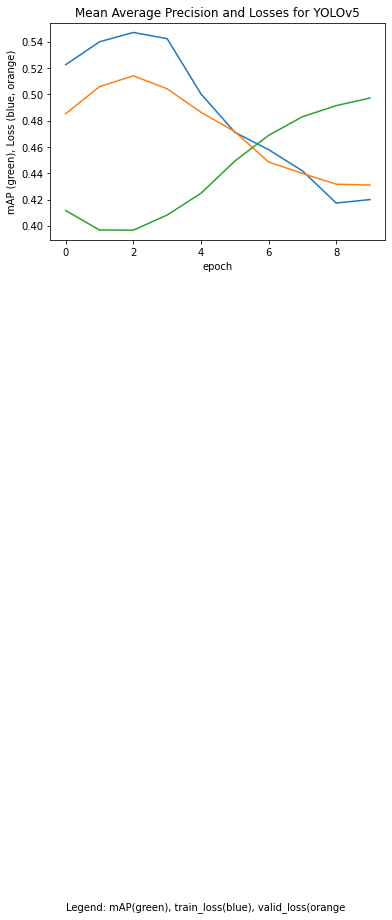

In [27]:
plot_metrics(learn_yolo, 'Mean Average Precision and Losses for YOLOv5', 0,-0.12)

  0%|          | 0/152149505 [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/mmcv/cnn/utils/weight_init.py:119: UserWarning: init_cfg without layer key, if you do not define override key either, this init_cfg will do nothing
  'init_cfg without layer key, if you do not define override'


Use load_from_local loader
The model and loaded state dict do not match exactly

size mismatch for bbox_head.retina_cls.weight: copying a param with shape torch.Size([720, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([180, 256, 3, 3]).
size mismatch for bbox_head.retina_cls.bias: copying a param with shape torch.Size([720]) from checkpoint, the shape in current model is torch.Size([180]).


SuggestedLRs(lr_min=4.786300996784121e-05, lr_steep=0.00015848931798245758)

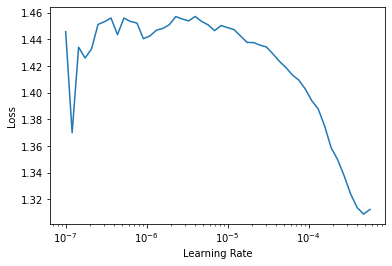

In [6]:
# using retinanet/ resnet50: focal loss
model_type_ret = models.mmdet.retinanet #
backbone_r50 = model_type_ret.backbones.resnet50_fpn_1x(pretrained=True)#
model_ret = model_type_ret.model(backbone=backbone_r50(pretrained=True), #
                      num_classes=len(parser.class_map))

train_dl_ret = model_type_ret.train_dl(train_ds, batch_size=16, num_workers=4, shuffle=True)#
valid_dl_ret = model_type_ret.valid_dl(valid_ds, batch_size=16, num_workers=4, shuffle=False)#

learn_ret = model_type_ret.fastai.learner(dls=[train_dl_ret, valid_dl_ret], model=model_ret, metrics=metrics)#
learn_ret.lr_find()#
# use ***

In [7]:
learn_ret.fine_tune(10,  4.786e-05, freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,0.602741,0.556301,0.368045,06:56


epoch,train_loss,valid_loss,COCOMetric,time
0,0.542519,0.519990,0.407884,07:36
1,0.521466,0.506190,0.417139,07:34
2,0.505581,0.500704,0.421123,07:33
3,0.483099,0.482933,0.435499,07:29
4,0.484139,0.486888,0.430257,07:28
5,0.456848,0.481238,0.434678,07:28
6,0.469312,0.476436,0.441399,07:27
7,0.442043,0.467799,0.451756,07:27
8,0.445329,0.467833,0.450663,07:28
9,0.425313,0.466511,0.451020,07:27


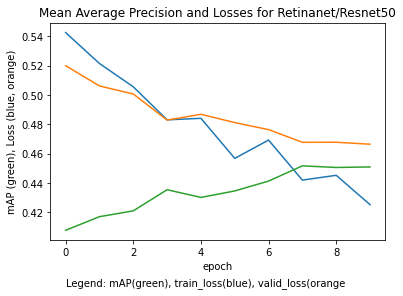

In [14]:
 plot_metrics(learn_ret, 'Mean Average Precision and Losses for Retinanet/Resnet50', 0, 0.37)

Downloading: "https://github.com/rwightman/efficientdet-pytorch/releases/download/v0.1/tf_efficientdet_lite0-f5f303a9.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientdet_lite0-f5f303a9.pth


SuggestedLRs(lr_min=0.03019951581954956, lr_steep=7.585775847473997e-07)

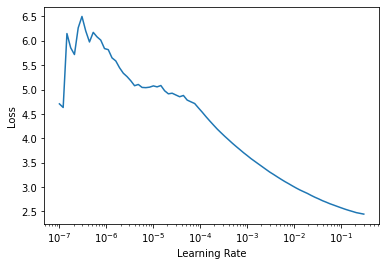

In [15]:
# using efficientdet
model_type_eff = models.ross.efficientdet ##
backbone_eff = model_type_eff.backbones.tf_lite0#
model_eff = model_type_eff.model(backbone = backbone_eff(pretrained=True), ##
                      num_classes=len(parser.class_map),
                      img_size = image_size)#
train_dl_eff = model_type_eff.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_eff = model_type_eff.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)
                                       
learn_eff = model_type_eff.fastai.learner(dls=[train_dl_eff, ###
                                                   valid_dl_eff], #
                                              model=model_eff, metrics=metrics)#
learn_eff.lr_find()#

In [16]:
learn_eff.fine_tune(10,  0.03, freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,0.754171,1.340414,0.178895,04:30


epoch,train_loss,valid_loss,COCOMetric,time
0,0.620616,0.599725,0.363258,05:06
1,0.651912,0.690180,0.267631,05:08
2,0.678783,0.728971,0.256289,05:05
3,0.648565,0.663312,0.281616,05:06
4,0.588329,0.610173,0.334747,05:05
5,0.561222,0.598908,0.348250,05:08
6,0.510843,0.550805,0.396549,05:08
7,0.473452,0.527641,0.419763,05:06


epoch,train_loss,valid_loss,COCOMetric,time
0,0.620616,0.599725,0.363258,05:06
1,0.651912,0.690180,0.267631,05:08
2,0.678783,0.728971,0.256289,05:05
3,0.648565,0.663312,0.281616,05:06
4,0.588329,0.610173,0.334747,05:05
5,0.561222,0.598908,0.348250,05:08
6,0.510843,0.550805,0.396549,05:08
7,0.473452,0.527641,0.419763,05:06
8,0.432668,0.511345,0.438453,05:08
9,0.420870,0.510452,0.441095,05:06


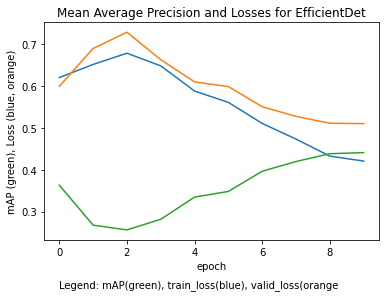

In [21]:
plot_metrics(learn_eff, 'Mean Average Precision and Losses for EfficientDet',0,0.12)

In [ ]:
## best model

In [22]:
# using YOLOv5: 1-stage
model_type_yolo = models.ultralytics.yolov5 ##
backbone_yolo = model_type_yolo.backbones.small #
model_yolo = model_type_yolo.model(backbone = backbone_yolo(pretrained=True), ###
                      num_classes=len(parser.class_map),
                      img_size = image_size)#
train_dl_yolo = model_type_yolo.train_dl(train_ds, ##
                      batch_size=16, num_workers=4, shuffle=True)
valid_dl_yolo = model_type_yolo.valid_dl(valid_ds, ##
                      batch_size=16, num_workers=4, shuffle=False)
                                       
learn_yolo = model_type_yolo.fastai.learner(dls=[train_dl_yolo, ###
                                                   valid_dl_yolo], #
                                              model=model_yolo, metrics=metrics)#
#learn_yolo.lr_find()#

  0%|          | 0.00/14.1M [00:00<?, ?B/s]

In [23]:
learn_yolo.fine_tune(8, 0.0033 , freeze_epochs=1) #

epoch,train_loss,valid_loss,COCOMetric,time
0,0.646912,0.612203,0.298220,02:24


epoch,train_loss,valid_loss,COCOMetric,time
0,0.511634,0.477818,0.447002,02:27
1,0.547794,0.516730,0.354011,02:28


epoch,train_loss,valid_loss,COCOMetric,time
0,0.511634,0.477818,0.447002,02:27
1,0.547794,0.516730,0.354011,02:28
2,0.508771,0.520757,0.396956,02:28
3,0.520220,0.490432,0.416527,02:29
4,0.481811,0.481117,0.452501,02:30
5,0.457238,0.449345,0.491040,02:28
6,0.424828,0.434939,0.496934,02:28
7,0.432115,0.434159,0.504855,02:28


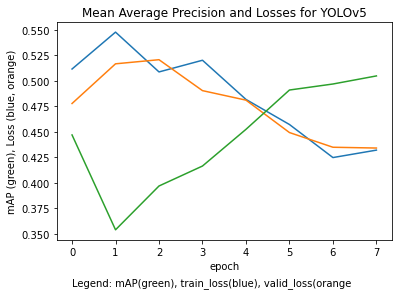

In [24]:
plot_metrics(learn_yolo, 'Mean Average Precision and Losses for YOLOv5', 0,0.3)

In [ ]:
## show results

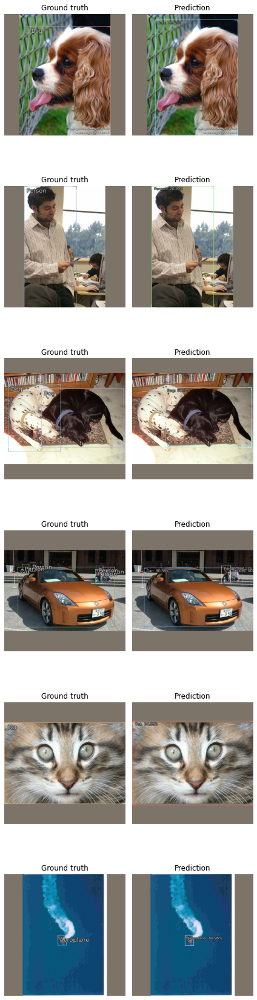

In [25]:
model_type_yolo.show_results(model_yolo, valid_ds, detection_threshold=.5)

In [38]:
# inference
!pip install bing-image-downloader
from bing_image_downloader import downloader
query_string = 'hummingbird' ##
hbird = downloader.download(query_string, limit = 2, 
                            output_dir = 'dataset',
                            adult_filter_off=True,
                            force_replace=False,
                            timeout=60,
                            verbose=True)
hbird

[%] Downloading Images to /content/dataset/hummingbird


[!!]Indexing page: 1

[%] Indexed 2 Images on Page 1.


[%] Downloading Image #1 from https://img1.southernliving.timeinc.net/sites/default/files/styles/medium_2x/public/image/2017/04/main/hummingbird-feeder.jpg?itok=8YOevL0m
[%] File Downloaded !

[%] Downloading Image #2 from http://strawberry.audubon.org/sites/g/files/amh581/f/styles/hero_mobile/public/editorial-card-images/static_page/leucistic_ruby-throated_hummingbird_006_cropped.jpg?itok=t90jd811
[%] File Downloaded !



[%] Done. Downloaded 2 images.

Please show your support here
https://www.buymeacoffee.com/gurugaurav




  0%|          | 0/204880 [00:00<?, ?B/s]

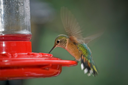

In [39]:
url = ['https://img1.southernliving.timeinc.net/sites/default/files/styles/medium_2x/public/image/2017/04/main/hummingbird-feeder.jpg?itok=8YOevL0m']
dest = 'Desktop'
download_url(url[0],dest) #

from PIL import Image

image = Image.open(dest)
image.to_thumb(128)

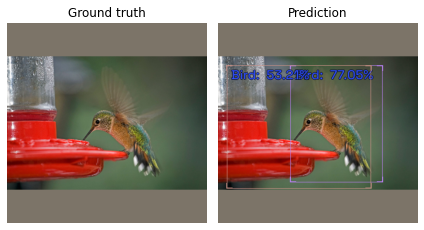

In [40]:
img = np.array(image)

infer_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size=384), tfms.A.Normalize()])

infer = Dataset.from_images([img], infer_tfms, class_map=class_map )#

# preds = model_type.predict(model, infer, keep_images=True)
preds = model_type_ret.predict(model_ret, infer, keep_images=True)##

show_preds(preds=preds, font_size=25,
                        label_color = '#3050ff', # blue

)

In [46]:
# inference
!pip install bing-image-downloader
from bing_image_downloader import downloader
query_string = 'road bike' ##
bike = downloader.download(query_string, limit = 2, 
                            output_dir = 'dataset',
                            adult_filter_off=True,
                            force_replace=False,
                            timeout=60,
                            verbose=True)
bike

[%] Downloading Images to /content/dataset/road bike


[!!]Indexing page: 1

[%] Indexed 2 Images on Page 1.


[%] Downloading Image #1 from https://i.pinimg.com/originals/c8/d3/31/c8d33122330dd50e296301fc438bf546.jpg
[%] File Downloaded !

[%] Downloading Image #2 from https://mountpleasantbia.com/wp-content/uploads/Activities_Service/1508436851.jpg
[!] Issue getting: https://mountpleasantbia.com/wp-content/uploads/Activities_Service/1508436851.jpg
[!] Error:: HTTP Error 404: Not Found


[!!]Indexing page: 2

[%] Indexed 35 Images on Page 2.


[%] Downloading Image #2 from https://i.pinimg.com/originals/c8/d3/31/c8d33122330dd50e296301fc438bf546.jpg
[%] File Downloaded !



[%] Done. Downloaded 2 images.

Please show your support here
https://www.buymeacoffee.com/gurugaurav




  0%|          | 0/178995 [00:00<?, ?B/s]

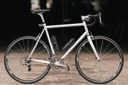

In [47]:
url =['https://i.pinimg.com/originals/c8/d3/31/c8d33122330dd50e296301fc438bf546.jpg']
dest = 'Desktop'
download_url(url[0],dest) #

from PIL import Image

image = Image.open(dest)
image.to_thumb(128)

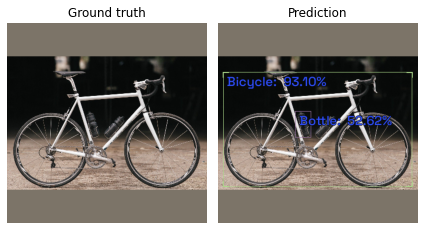

In [48]:
img = np.array(image)

infer_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size=384), tfms.A.Normalize()])

infer = Dataset.from_images([img], infer_tfms, class_map=class_map )#

# preds = model_type.predict(model, infer, keep_images=True)
preds = model_type_ret.predict(model_ret, infer, keep_images=True)##

show_preds(preds=preds, font_size=25,
                        label_color = '#3050ff', # blue

)